#Dependencies & Prerequisites

In [39]:
cd /Users/wwhfreddy/Downloads/

/Users/wwhfreddy/Downloads


In [2]:
%matplotlib inline
import matplotlib as mpl
from matplotlib import pylab as plt
import matplotlib.dates as mdates
import seaborn as sns
import pandas as pd
import collections

import numpy as np
import tensorflow.compat.v2 as tf
import tensorflow_probability as tfp

from tensorflow_probability import distributions as tfd
from tensorflow_probability import sts

tf.enable_v2_behavior()

In [3]:
if tf.test.gpu_device_name() != '/device:GPU:0':
  print('WARNING: GPU device not found.')
else:
  print('SUCCESS: Found GPU: {}'.format(tf.test.gpu_device_name()))

Metal device set to: Apple M1 Pro
SUCCESS: Found GPU: /device:GPU:0


2022-11-19 21:10:26.264757: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2022-11-19 21:10:26.266308: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
2022-11-19 21:10:26.275380: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2022-11-19 21:10:26.275416: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


# Plotting setup

In [5]:
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()

sns.set_context("notebook", font_scale=1.)
sns.set_style("whitegrid")
%config InlineBackend.figure_format = 'retina'

In [6]:
def plot_forecast(x, y,
                  forecast_mean, forecast_scale, forecast_samples,
                  title, x_locator=None, x_formatter=None):
  """Plot a forecast distribution against the 'true' time series."""
  colors = sns.color_palette()
  c1, c2 = colors[0], colors[1]
  fig = plt.figure(figsize=(12, 6))
  ax = fig.add_subplot(1, 1, 1)

  num_steps = len(y)
  num_steps_forecast = forecast_mean.shape[-1]
  num_steps_train = num_steps - num_steps_forecast


  ax.plot(x, y, lw=2, color=c1, label='ground truth')

  forecast_steps = np.arange(
      x[num_steps_train],
      x[num_steps_train]+num_steps_forecast,
      dtype=x.dtype)

  ax.plot(forecast_steps, forecast_samples.T, lw=1, color=c2, alpha=0.1)

  ax.plot(forecast_steps, forecast_mean, lw=2, ls='--', color=c2,
           label='forecast')
  ax.fill_between(forecast_steps,
                   forecast_mean-2*forecast_scale,
                   forecast_mean+2*forecast_scale, color=c2, alpha=0.2)

  ymin, ymax = min(np.min(forecast_samples), np.min(y)), max(np.max(forecast_samples), np.max(y))
  yrange = ymax-ymin
  ax.set_ylim([ymin - yrange*0.1, ymax + yrange*0.1])
  ax.set_title("{}".format(title))
  ax.legend()

  if x_locator is not None:
    ax.xaxis.set_major_locator(x_locator)
    ax.xaxis.set_major_formatter(x_formatter)
    fig.autofmt_xdate()

  return fig, ax

In [7]:
def plot_components(dates,
                    component_means_dict,
                    component_stddevs_dict,
                    x_locator=None,
                    x_formatter=None):
  """Plot the contributions of posterior components in a single figure."""
  colors = sns.color_palette()
  c1, c2 = colors[0], colors[1]

  axes_dict = collections.OrderedDict()
  num_components = len(component_means_dict)
  fig = plt.figure(figsize=(12, 2.5 * num_components))
  for i, component_name in enumerate(component_means_dict.keys()):
    component_mean = component_means_dict[component_name]
    component_stddev = component_stddevs_dict[component_name]

    ax = fig.add_subplot(num_components,1,1+i)
    ax.plot(dates, component_mean, lw=2)
    ax.fill_between(dates,
                     component_mean-2*component_stddev,
                     component_mean+2*component_stddev,
                     color=c2, alpha=0.5)
    ax.set_title(component_name)
    if x_locator is not None:
      ax.xaxis.set_major_locator(x_locator)
      ax.xaxis.set_major_formatter(x_formatter)
    axes_dict[component_name] = ax
  fig.autofmt_xdate()
  fig.tight_layout()
  return fig, axes_dict

In [8]:
def plot_one_step_predictive(dates, observed_time_series,
                             one_step_mean, one_step_scale,
                             x_locator=None, x_formatter=None):
  """Plot a time series against a model's one-step predictions."""

  colors = sns.color_palette()
  c1, c2 = colors[0], colors[1]

  fig=plt.figure(figsize=(12, 6))
  ax = fig.add_subplot(1,1,1)
  num_timesteps = one_step_mean.shape[-1]
  ax.plot(dates, observed_time_series, label="observed time series", color=c1)
  ax.plot(dates, one_step_mean, label="one-step prediction", color=c2)
  ax.fill_between(dates,
                  one_step_mean - one_step_scale,
                  one_step_mean + one_step_scale,
                  alpha=0.1, color=c2)
  ax.legend()

  if x_locator is not None:
    ax.xaxis.set_major_locator(x_locator)
    ax.xaxis.set_major_formatter(x_formatter)
    fig.autofmt_xdate()
  fig.tight_layout()
  return fig, ax

# Modelling with HCMC

In [41]:
dic_country = \
{'AUS': 'Australia',
 'BRA': 'Brazil',
 'CAN': 'India',
 'CHN': 'China',
 'GBR': 'United Kingdom',
 'IND': 'India',
 'JPN': 'Japan',
 'SGP': 'Singapore',
 'USA': 'United States'}
datas_m_raw = pd.ExcelFile('../../Data/cleaned/Manufacturing_filled.xlsx')
datas_s_raw = pd.ExcelFile('../../Data/cleaned/Service_filled.xlsx')
datas_m = {}
datas_s = {}
for con in dic_country.keys():
    datas_m[con] = pd.read_excel(datas_m_raw, sheet_name=con)
    datas_s[con] = pd.read_excel(datas_s_raw, sheet_name=con)

In [42]:
year=datas_m['USA']["Year"].to_numpy()
value=datas_m['USA'].iloc[:,-1].to_numpy()
num_forecast_steps = round(len(value)*0.2)
training_data = value[:-num_forecast_steps]
print(num_forecast_steps)

5


In [44]:
def build_model(observed_time_series):
  trend = sts.LocalLinearTrend(observed_time_series=observed_time_series)
  autoregressive = sts.Autoregressive(
      order=1,
      observed_time_series=observed_time_series,
      name='autoregressive')
  arima=sts.AutoregressiveIntegratedMovingAverage(
    ar_order=1,
    ma_order=1,
    integration_degree=0,
    ar_coefficients_prior=None,
    ma_coefficients_prior=None,
    level_drift_prior=None,
    level_scale_prior=None,
    initial_state_prior=None,
    ar_coefficient_constraining_bijector=None,
    ma_coefficient_constraining_bijector=None,
    observed_time_series=observed_time_series,
    name=None
)
  model = sts.Sum([arima,trend], observed_time_series=observed_time_series)
  return model

##  Variational inference

In [45]:
model = build_model(training_data)
variational_posteriors = tfp.sts.build_factored_surrogate_posterior(
    model=model)

In [ ]:
with tf.device('/CPU:0'):
  num_variational_steps = 150 
# Build and optimize the variational loss function.
  elbo_loss_curve = tfp.vi.fit_surrogate_posterior(
    target_log_prob_fn=model.joint_distribution(
        observed_time_series=training_data).log_prob,
    surrogate_posterior=variational_posteriors,
    optimizer=tf.optimizers.Adam(learning_rate=0.1),
    num_steps=num_variational_steps,
    jit_compile=True)

  plt.plot(elbo_loss_curve)
  plt.show()


In [35]:
# Draw samples from the variational posterior.
q_samples = variational_posteriors.sample(60)

In [36]:
print("Inferred parameters:")
for param in model.parameters:
  print("{}: {} +- {}".format(param.name,
                              np.mean(q_samples[param.name], axis=0),
                              np.std(q_samples[param.name], axis=0)))

Inferred parameters:
observation_noise_scale: 0.7423171957519374 +- 0.006356678068088669
ARIMA/_ar_coefficients: [-0.81166681] +- [0.00335907]
ARIMA/_ma_coefficients: [-0.2159873] +- [0.01043649]
ARIMA/_level_scale: 0.4902653518698239 +- 0.003718646463396282
LocalLinearTrend/_level_scale: 1.2073778298646338 +- 0.007989846371813169
LocalLinearTrend/_slope_scale: 0.2685356697163578 +- 0.002678863816654324


## MCMC

In [ ]:
samples, kernel_results=tfp.sts.fit_with_hmc(
    model,
    training_data,
    num_results=100,
    num_warmup_steps=50,
    num_leapfrog_steps=15,
    initial_state=None,
    initial_step_size=None,
    chain_batch_shape=[10],
    num_variational_steps=100,
    variational_optimizer=None,
    variational_sample_size=10,
    seed=None,
    name=None
)

In [ ]:
print("acceptance rate: {}".format(
  np.mean(kernel_results.inner_results.inner_results.is_accepted, axis=0)))
print("posterior means: {}".format(
  {param.name: np.mean(param_draws, axis=0)
   for (param, param_draws) in zip(model.parameters, samples)}))
for (param, param_draws) in zip(model.parameters, samples):
  if param.prior.event_shape.ndims > 0:
    print("Only plotting traces for scalar parameters, skipping {}".format(
      param.name))
    continue
  plt.figure(figsize=[10, 4])
  plt.title(param.name)
  plt.plot(param_draws.numpy())
  plt.ylabel(param.name)
  plt.xlabel("HMC step")

# Combining the samples from multiple chains into a single dimension allows
# us to easily pass sampled parameters to downstream forecasting methods.
combined_samples = [np.reshape(param_draws,
                               [-1] + list(param_draws.shape[2:]))
                    for param_draws in samples]

## Forecasting

In [ ]:
forecast_dist = tfp.sts.forecast(
    model,
    observed_time_series=training_data,
    parameter_samples=q_samples,
    num_steps_forecast=num_forecast_steps)

In [ ]:
num_samples=80

forecast_mean, forecast_scale, forecast_samples = (
    forecast_dist.mean().numpy()[..., 0],
    forecast_dist.stddev().numpy()[..., 0],
    forecast_dist.sample(num_samples).numpy()[..., 0])

In [ ]:
forecast_mean

array([11.51317169, 11.36733288, 11.22440838, 11.08246941, 10.94077285])

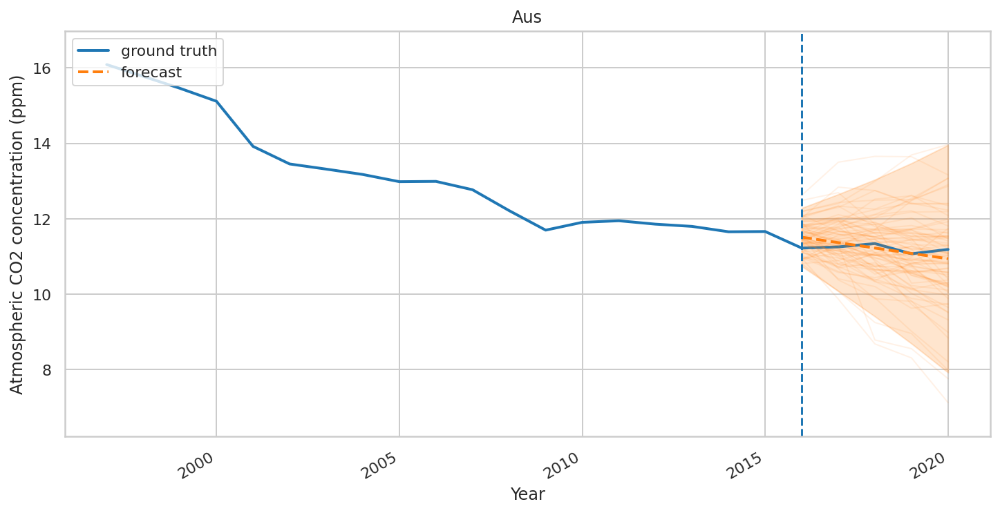

In [ ]:
fig, ax = plot_forecast(
    year,value,
    forecast_mean, forecast_scale, forecast_samples,
    title="Aus")
ax.axvline(year[-num_forecast_steps], linestyle="--")
ax.legend(loc="upper left")
ax.set_ylabel("Atmospheric CO2 concentration (ppm)")
ax.set_xlabel("Year")
fig.autofmt_xdate()

In [10]:
def MAE(y_pred, y_real, verbose = 1):
  E = y_pred-y_real
  return np.mean(np.abs(E), axis = 0), np.mean(np.abs(E))

def MSE(y_pred, y_real):
  E = y_pred-y_real
  return np.mean(np.square(E), axis = 0), np.mean(np.square(E))

def RMSE(y_pred, y_real):
  np.sqrt(MSE(y_pred, y_real)[0])
  return np.sqrt(MSE(y_pred, y_real)[0]), np.sqrt(MSE(y_pred, y_real)[1])
def MAPE(actual, pred): 
    actual, pred = np.array(actual), np.array(pred)
    return np.mean(np.abs((actual - pred) / actual)) 

In [ ]:
print(MAE(forecast_mean,value[-num_forecast_steps:]))
print(MAPE(forecast_mean,value[-num_forecast_steps:]))
print(RMSE(forecast_mean,value[-num_forecast_steps:]))

(0.15552270180053007, 0.15552270180053007)
0.013817740606591111
(0.18519189752657939, 0.18519189752657939)


#Pipeline

In [24]:
def build_model(observed_time_series):
  trend = sts.LocalLinearTrend(observed_time_series=observed_time_series)
  autoregressive = sts.Autoregressive(
      order=1,
      observed_time_series=observed_time_series,
      name='autoregressive')
  arima=sts.AutoregressiveIntegratedMovingAverage(
    ar_order=1,
    ma_order=1,
    integration_degree=0,
    ar_coefficients_prior=None,
    ma_coefficients_prior=None,
    level_drift_prior=None,
    level_scale_prior=None,
    initial_state_prior=None,
    ar_coefficient_constraining_bijector=None,
    ma_coefficient_constraining_bijector=None,
    observed_time_series=observed_time_series,
    name=None
)
  model = sts.Sum([arima,trend], observed_time_series=observed_time_series)
  return model

In [11]:
def pipeline(country="USA",dataset=0,ratio=0.2):
  if dataset==0:
    year=datas_m[country]["Year"].to_numpy()
    value=datas_m[country].iloc[:,-1].to_numpy()
    k="Manufacturing_value added_%_of_GDP"
  elif dataset==1:
    year=datas_s[country]["Year"].to_numpy()
    value=datas_s[country].iloc[:,-1].to_numpy()
    k="Service_value added_%_of_GDP"
  num_forecast_steps = round(len(value)*ratio)
  training_data = value[:-num_forecast_steps]
  model = build_model(training_data)
  samples, kernel_results=tfp.sts.fit_with_hmc(
    model,
    training_data,
    num_results=100,
    num_warmup_steps=50,
    num_leapfrog_steps=15,
    initial_state=None,
    initial_step_size=None,
    chain_batch_shape=[10],
    num_variational_steps=90,
    variational_optimizer=None,
    variational_sample_size=10,
    seed=None,
    name=None
  )
  for (param, param_draws) in zip(model.parameters, samples):
    if param.prior.event_shape.ndims > 0:
      print("Only plotting traces for scalar parameters, skipping {}".format(
      param.name))
    continue
  plt.figure(figsize=[10, 4])
  plt.title(param.name)
  plt.plot(param_draws.numpy())
  plt.ylabel(param.name)
  plt.xlabel("HMC step")
  combined_samples = [np.reshape(param_draws,
                               [-1] + list(param_draws.shape[2:]))
                    for param_draws in samples]
  forecast_dist = tfp.sts.forecast(
    model,
    observed_time_series=training_data,
    parameter_samples=combined_samples,
    num_steps_forecast=num_forecast_steps)
  num_samples=10
  forecast_mean, forecast_scale, forecast_samples = (
    forecast_dist.mean().numpy()[..., 0],
    forecast_dist.stddev().numpy()[..., 0],
    forecast_dist.sample(num_samples).numpy()[..., 0])
  SMAE,SMAPE,SRMSE=0,0,0
  SMAE=MAE(forecast_mean,value[-num_forecast_steps:])[1]
  SMAPE=MAPE(forecast_mean,value[-num_forecast_steps:])
  SRMSE=RMSE(forecast_mean,value[-num_forecast_steps:])[1]
  fig, ax = plot_forecast(
    year,value,
    forecast_mean, forecast_scale, forecast_samples,
    title=country)
  ax.axvline(year[-num_forecast_steps], linestyle="--")
  ax.legend(loc="upper left")
  ax.set_ylabel(k)
  ax.set_xlabel("Year")
  fig.autofmt_xdate()
  return SMAE,SMAPE,SRMSE


In [12]:
c, m, a, s, r,k = [], [], [], [], [],[]

In [13]:
testratio=[0.2,0.3]

Australia Manufacturing 0.2


2022-11-19 21:12:21.333180: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


Brazil Manufacturing 0.2


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


India Manufacturing 0.2


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


China Manufacturing 0.2


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


United Kingdom Manufacturing 0.2


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


India Manufacturing 0.2


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


Japan Manufacturing 0.2


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


Singapore Manufacturing 0.2


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


United States Manufacturing 0.2


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


Australia Manufacturing 0.3


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


Brazil Manufacturing 0.3


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


/var/folders/k2/cqvyq3yd59b52sjbsyrmhcy00000gn/T/ipykernel_22742/2717843047.py:33: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=[10, 4])




India Manufacturing 0.3


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


China Manufacturing 0.3


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


United Kingdom Manufacturing 0.3


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


India Manufacturing 0.3


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


Japan Manufacturing 0.3


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


Singapore Manufacturing 0.3


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


United States Manufacturing 0.3


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients




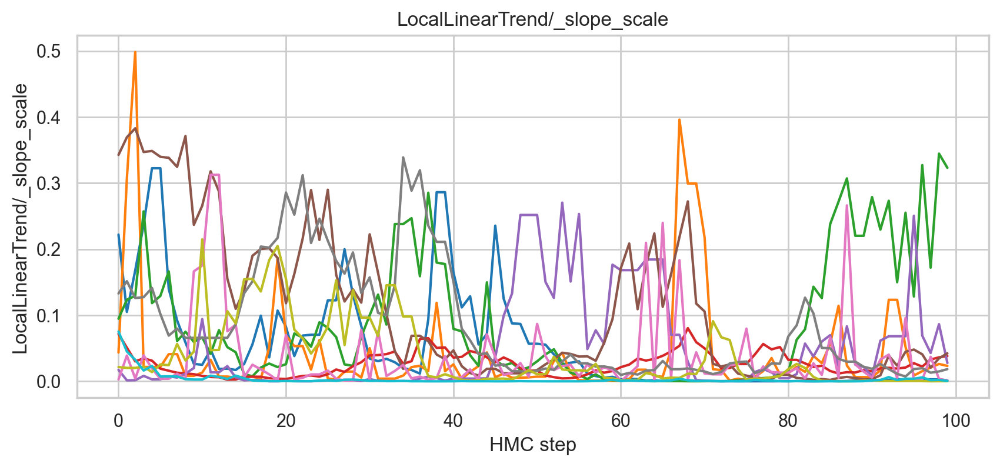

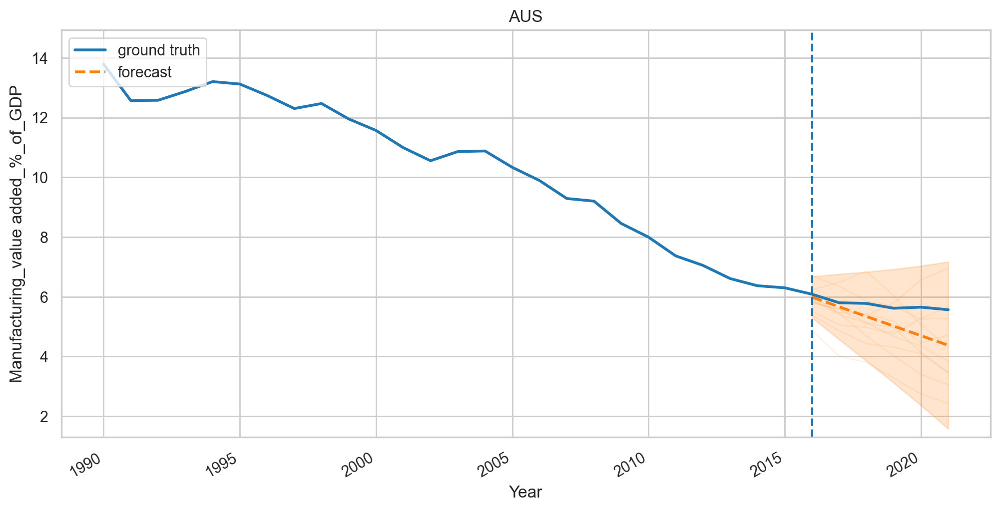

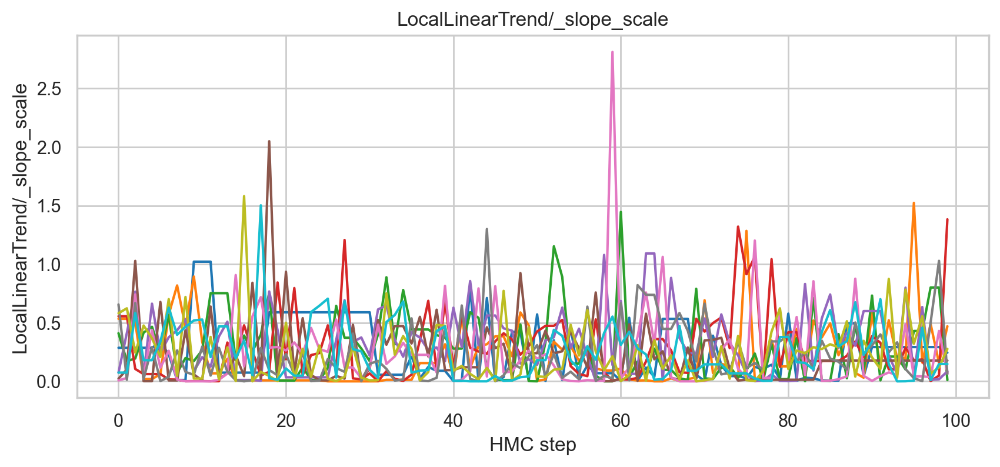

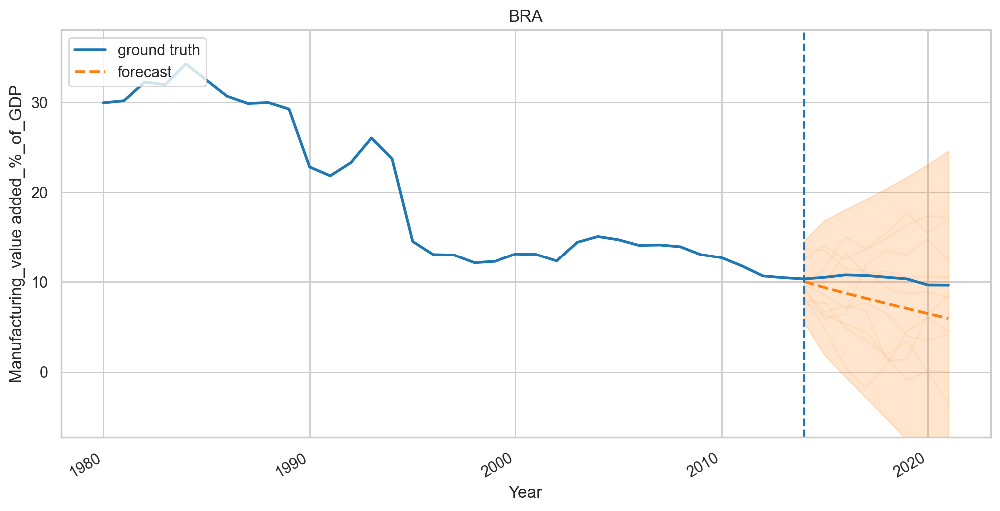

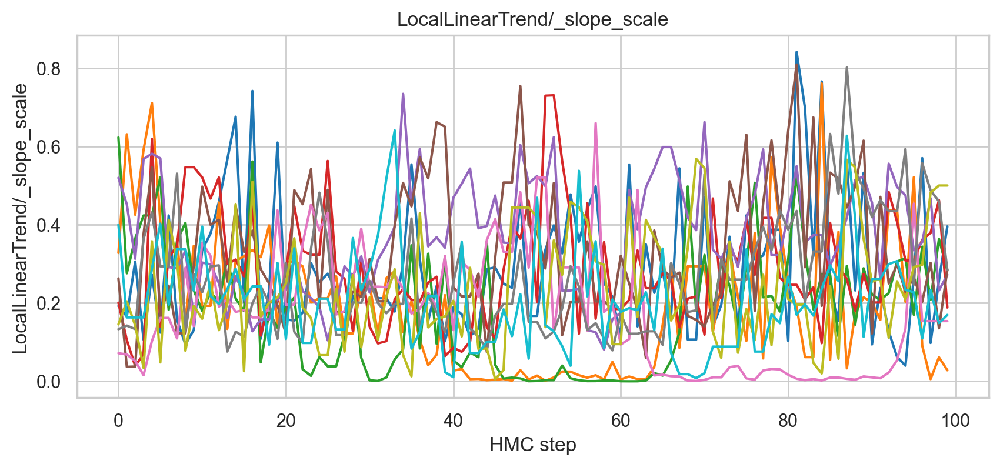

...

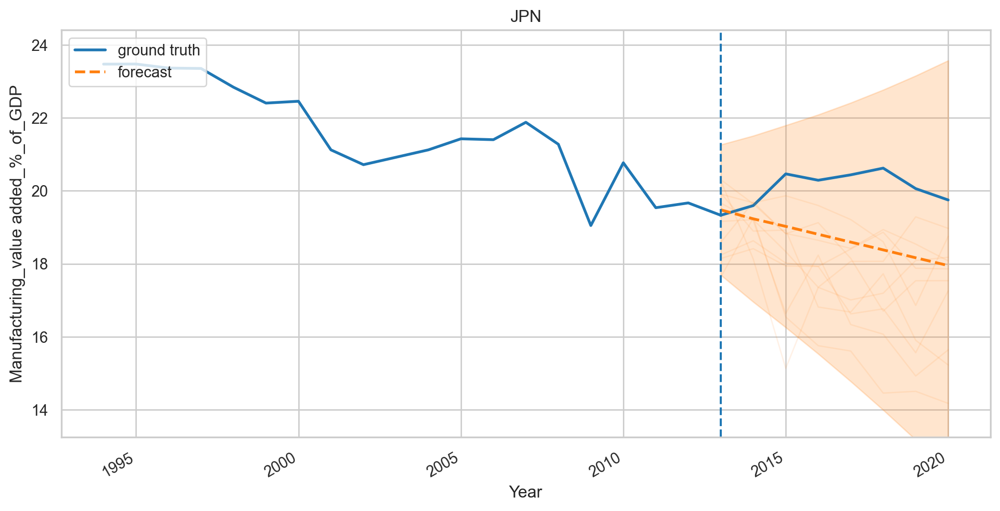

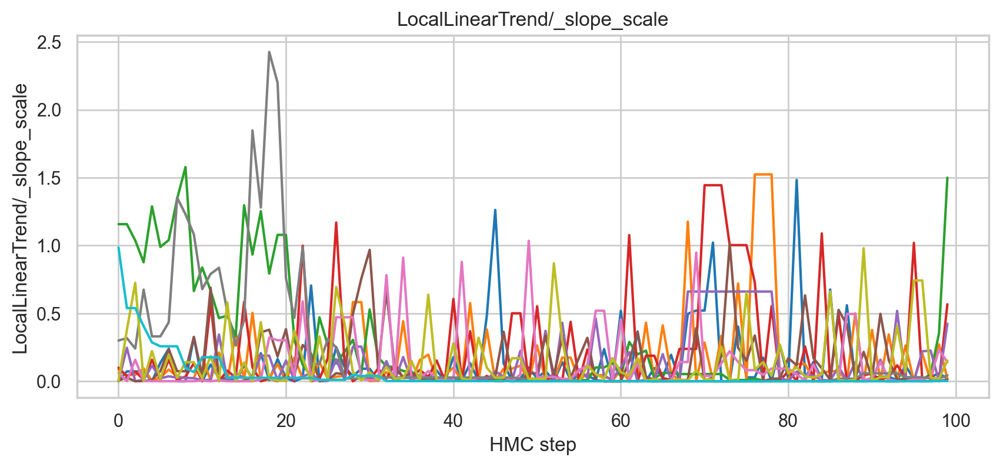

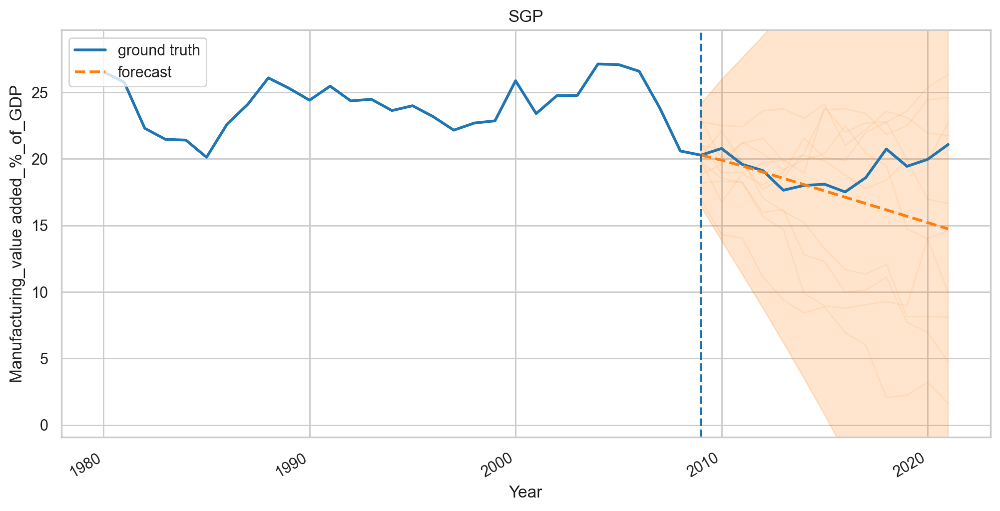

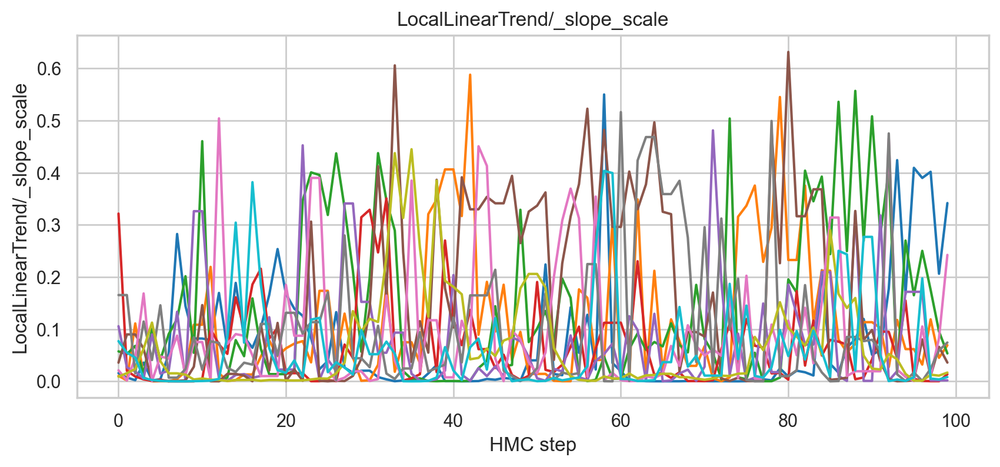

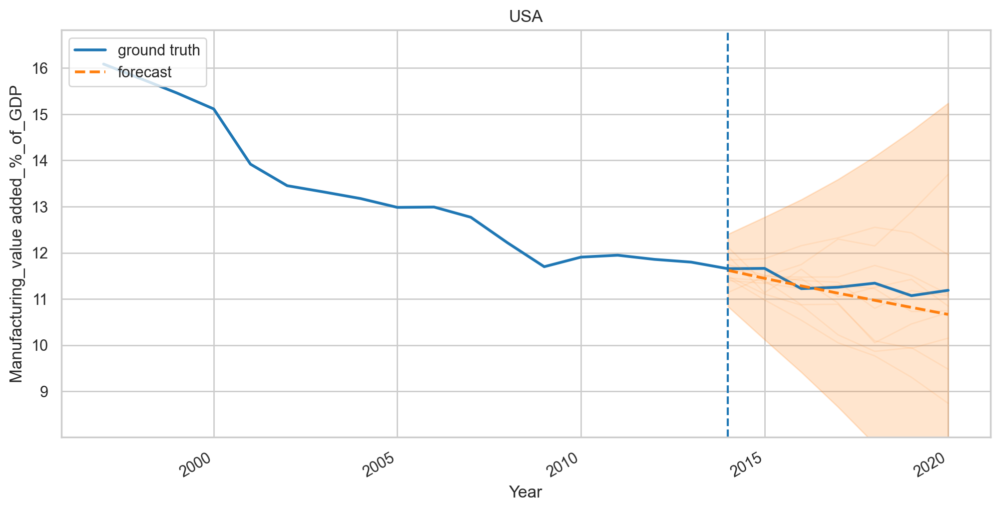

In [17]:
with tf.device('/CPU:0'):
  for ratio in testratio:
    for country in dic_country:
     print(dic_country[country], 'Manufacturing',ratio)
     a1, s1, r1 = pipeline(country, 0,ratio)
     c.append(country)
     m.append('Manufacturing')
     a.append(a1)
     s.append(s1)
     r.append(r1)
     k.append(ratio)
     print('\n')

In [18]:
c2, m2, a2, s2, r2,k2 = [], [], [], [], [],[]

Australia Service 0.2


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


Brazil Service 0.2


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


India Service 0.2


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


China Service 0.2


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


United Kingdom Service 0.2


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


India Service 0.2


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


Japan Service 0.2


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


Singapore Service 0.2


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


United States Service 0.2


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


Australia Service 0.3


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


Brazil Service 0.3


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


/var/folders/k2/cqvyq3yd59b52sjbsyrmhcy00000gn/T/ipykernel_22742/2717843047.py:33: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=[10, 4])




India Service 0.3


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


China Service 0.3


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


United Kingdom Service 0.3


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


India Service 0.3


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


Japan Service 0.3


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


Singapore Service 0.3


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients


United States Service 0.3


/Users/wwhfreddy/miniforge3/envs/tensorflow_silicon/lib/python3.9/site-packages/tensorflow_probability/python/mcmc/sample.py:339: UserWarning: Tracing all kernel results by default is deprecated. Set the `trace_fn` argument to None (the future default value) or an explicit callback that traces the values you are interested in.
  warnings.warn('Tracing all kernel results by default is deprecated. Set '


Only plotting traces for scalar parameters, skipping ARIMA/_ar_coefficients
Only plotting traces for scalar parameters, skipping ARIMA/_ma_coefficients




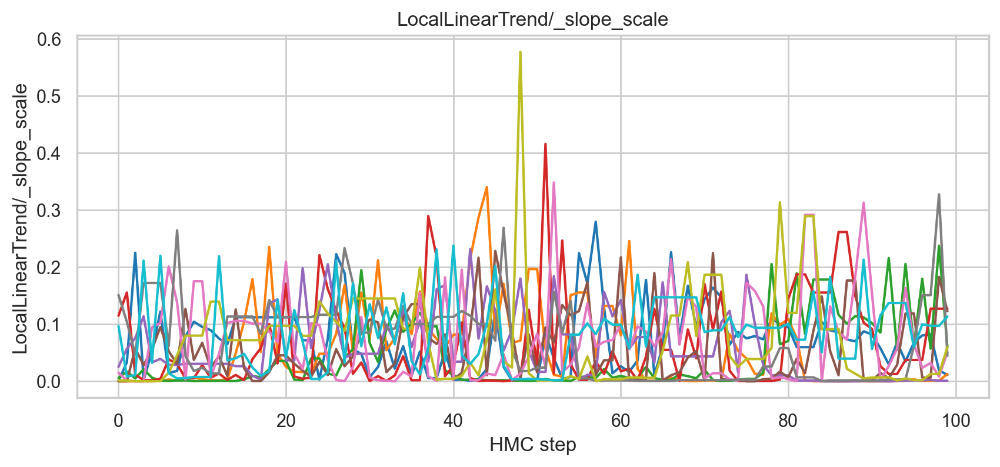

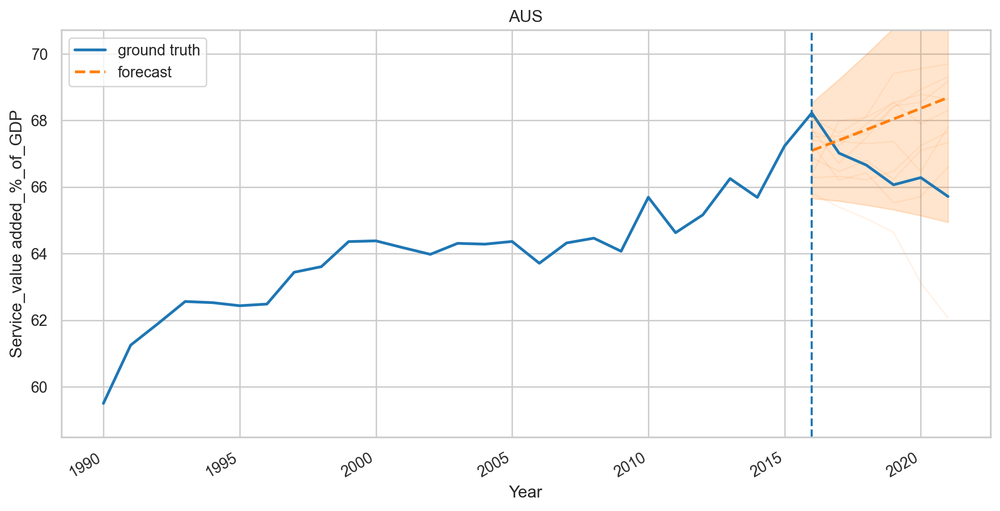

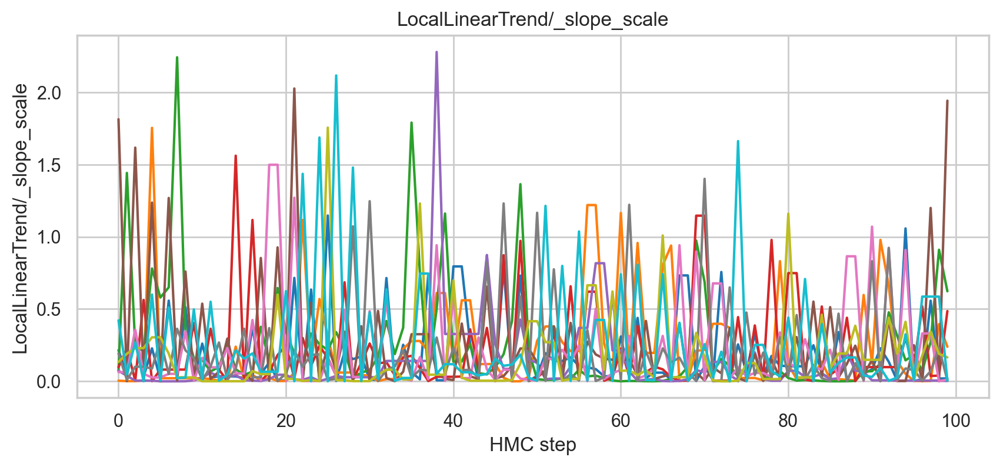

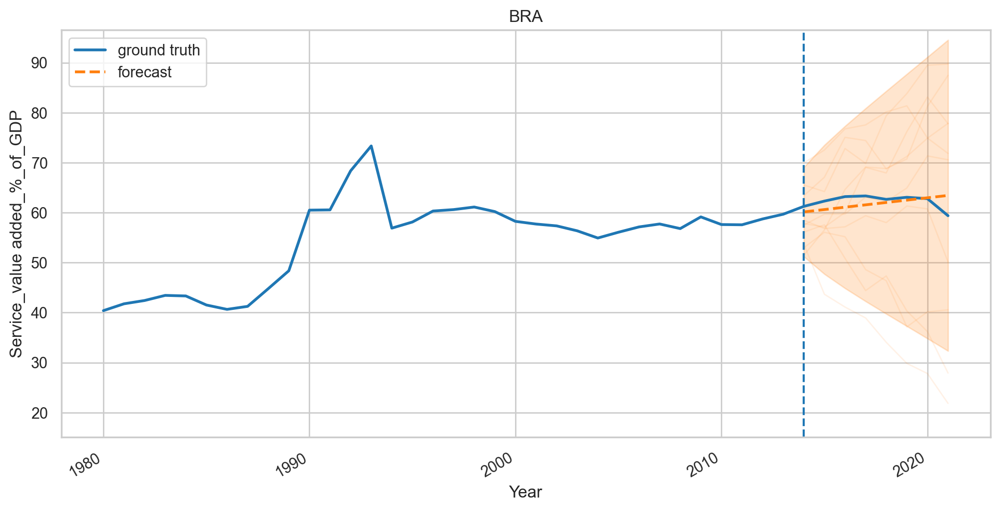

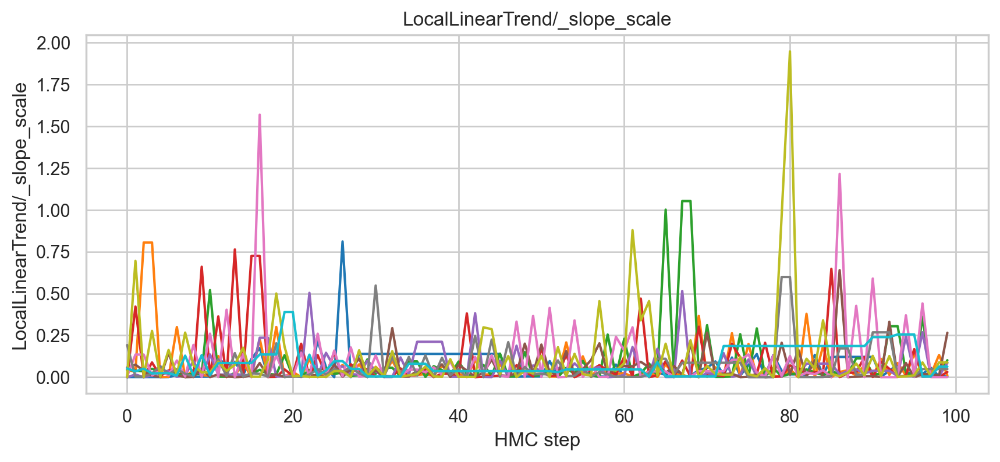

...

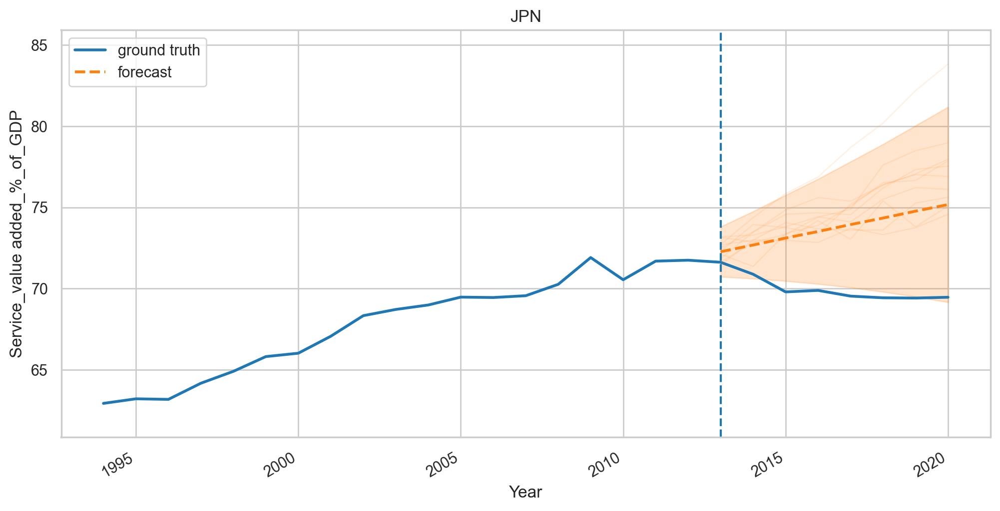

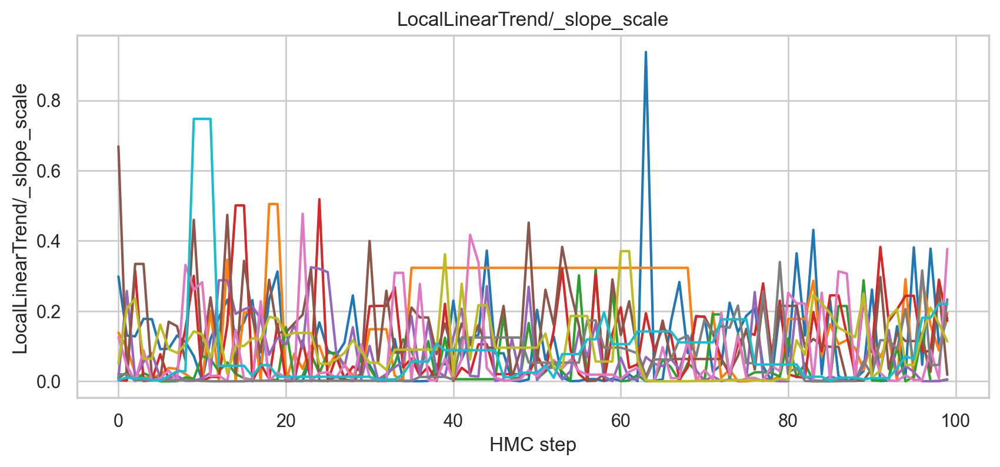

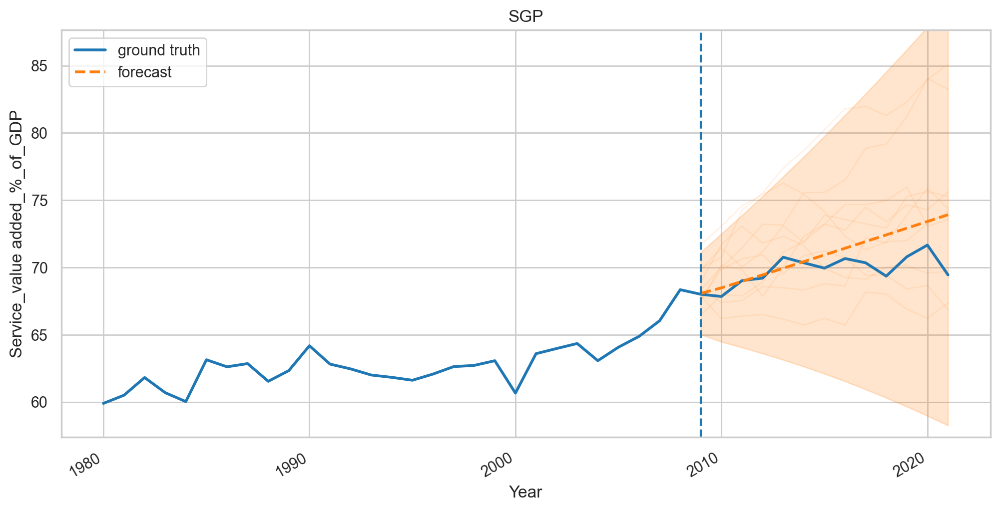

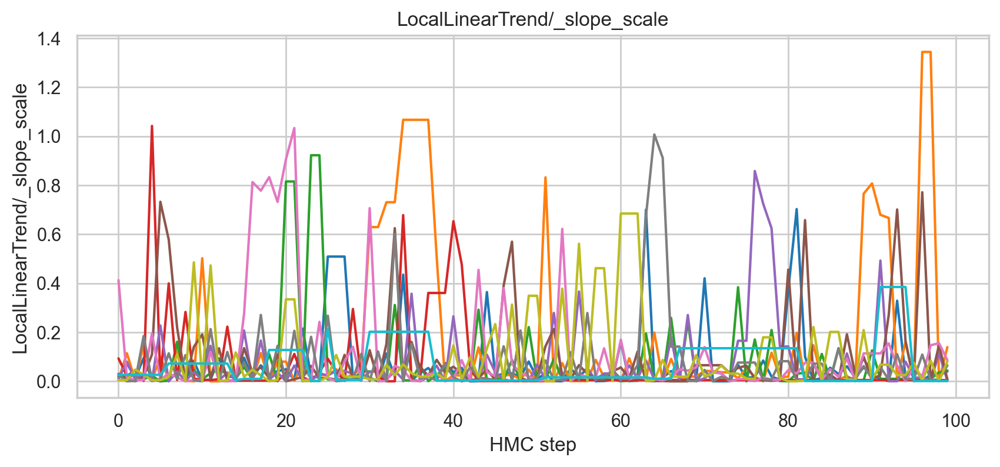

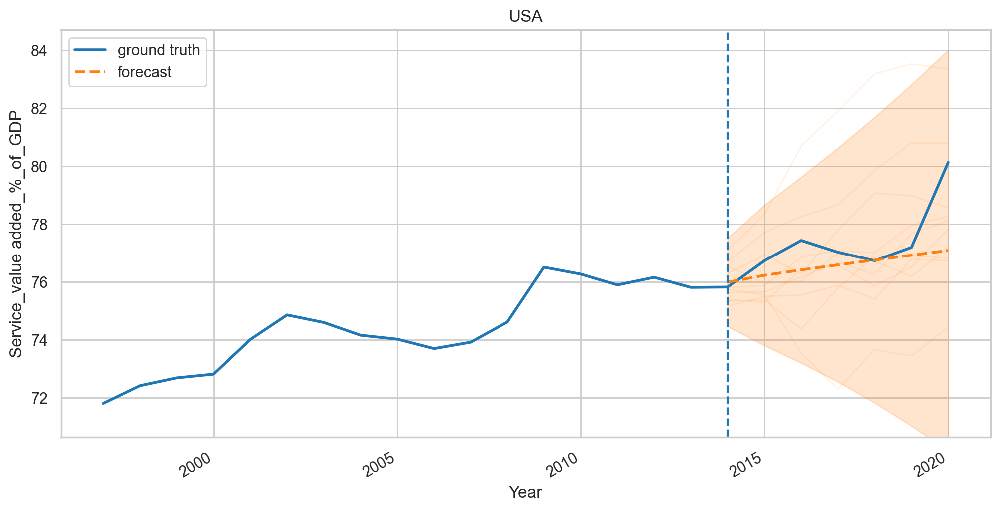

In [20]:
with tf.device('/CPU:0'):
  for ratio in testratio:
    for country in dic_country:
     print(dic_country[country], 'Service',ratio)
     a1, s1, r1 = pipeline(country, 1,ratio)
     c2.append(country)
     m2.append('Service')
     a2.append(a1)
     s2.append(s1)
     r2.append(r1)
     k2.append(ratio)
     print('\n')

# Performance

In [23]:
print("Manufacturing")
manu_df_result=pd.DataFrame({
    'country': c,
    'method': m,
    "test ratio": k,
    'MAE': a,
    'MAPE': s,
    'RMSE': r
})
print("Mean Performace")
print(manu_df_result.groupby("country").mean())
print("\nCountry Performace")
print(manu_df_result)

print("Service")
ser_df_result=pd.DataFrame({
    'country': c2,
    'method': m2,
    "test ratio": k2,
    'MAE': a2,
    'MAPE': s2,
    'RMSE': r2
})
print("Mean Performace")
print(ser_df_result.groupby("country").mean())
print("\nCountry Performace")
print(ser_df_result)

Manufacturing
Mean Performace
         test ratio       MAE      MAPE      RMSE
country                                          
AUS            0.25  0.849656  0.207589  1.050534
BRA            0.25  1.537094  0.200058  1.706705
CAN            0.25  1.276556  0.156201  1.397606
CHN            0.25  1.064075  0.041570  1.217449
GBR            0.25  0.374404  0.045209  0.403516
IND            0.25  1.234775  0.074149  1.503939
JPN            0.25  1.014058  0.053889  1.118181
SGP            0.25  2.460984  0.156989  3.225912
USA            0.25  0.188964  0.017012  0.227520

Country Performace
   country         method  test ratio       MAE      MAPE      RMSE
0      AUS  Manufacturing         0.2  0.569093  0.119462  0.695677
1      BRA  Manufacturing         0.2  2.380686  0.331125  2.619614
2      CAN  Manufacturing         0.2  1.065979  0.122084  1.091471
3      CHN  Manufacturing         0.2  0.554572  0.020552  0.621016
4      GBR  Manufacturing         0.2  0.092625  0.010335  0

/var/folders/k2/cqvyq3yd59b52sjbsyrmhcy00000gn/T/ipykernel_22742/571576700.py:11: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  print(manu_df_result.groupby("country").mean())
/var/folders/k2/cqvyq3yd59b52sjbsyrmhcy00000gn/T/ipykernel_22742/571576700.py:25: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  print(ser_df_result.groupby("country").mean())
